# CLIP Feature Attribution via LibraGrad

You can open this notebook on [Google Colab](https://colab.research.google.com/github/NightMachinery/LibraGrad/blob/master/notebooks/CLIP.ipynb).

## Install Dependencies

In [1]:
! sudo apt install -y zsh

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  zsh-common
Suggested packages:
  zsh-doc
The following NEW packages will be installed:
  zsh zsh-common
0 upgraded, 2 newly installed, 0 to remove and 49 not upgraded.
Need to get 4,794 kB of archives.
After this operation, 18.2 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 zsh-common all 5.8.1-1 [3,985 kB]
Get:2 http://archive.ubuntu.com/ubuntu jammy/main amd64 zsh amd64 5.8.1-1 [809 kB]
Fetched 4,794 kB in 0s (11.7 MB/s)
debconf: unable to initialize frontend: Dialog
debconf: (No usable dialog-like program is installed, so the dialog based frontend cannot be used. at /usr/share/perl5/Debconf/FrontEnd/Dialog.pm line 78, <> line 2.)
debconf: falling back to frontend: Readline
debconf: unable to initialize frontend: Readline
debconf: (This frontend requires a controlling tty.)
debconf: 

In [9]:
%%script zsh

#!/usr/bin/env zsh
# Activate your desired virtual env at the start:
# micromamba activate libra_1
###
export PS4='> '
set -exo pipefail
###
function libra-public-p {
    if isMB2 ; then
        return 1
    else
        return 0
    fi
}

if libra-public-p ; then
    PIP_INSTALL_P="${PIP_INSTALL_P-y}"
else
    PIP_INSTALL_P="${PIP_INSTALL_P}"
fi

function libra-git-push {
    if ! libra-public-p ; then
        #: Do NOT push if we are running publicly.
        ##
        git push
    fi
}
###
#: @duplicateCode
##
ec() {
    printf "%s\n" "$*"
}

ecerr() {
    ec "$@" >&2
}
##
pip-install() {
    if [[ "$1" =~ '^git\+' ]]
    then
        pip install "$@"
        pip install --no-deps --force-reinstall "$@"
    else
        command uv pip install --system -U "$@"
    fi
}
##
function git-clean-p {
  git diff-index --quiet HEAD --
  #: --quiet  Disable all output of the program. Implies --exit-code.
  #: --exit-code  Make the program exit with codes similar to diff(1). That is, it  exits with 1 if there were differences and 0 means no differences.
}

function git-dirty-p {
  ! git-clean-p
}
###
if isMB2 ; then
    CODE_DIR=~/code/uni
else
    if libra-public-p ; then
        CODE_DIR=~/libra_1
    else
        CODE_DIR=~/code
    fi
fi
mkdir -p "${CODE_DIR}"
##
if libra-public-p ; then
    decompv_url='https://github.com/NightMachinery/decompv-libragrad-v1.git'
    timm_url='https://github.com/NightMachinery/pytorch-image-models-libragrad-v1.git'
    pynight_url='https://github.com/NightMachinery/PyNight.git'
    # pynight_url='git@github.com:NightMachinery/PyNight.git'
    # decompv_url='git@github.com:NightMachinery/decompv-libragrad-v1.git'
    # timm_url='git@github.com:NightMachinery/pytorch-image-models-libragrad-v1.git'
    
else
    pynight_url='git@github.com:NightMachinery/PyNight.git'
    decompv_url='git@github.com:NightMachinery/DecompV.git'
    timm_url='git@github.com:NightMachinery/pytorch-image-models.git'
fi

if test -n "$PIP_INSTALL_P" ; then
    pip install -U pip uv
fi

##
cd "${CODE_DIR}"
if ! test -e DecompV ; then
    git clone "${decompv_url}" DecompV
fi
cd DecompV

if git-dirty-p ; then
    ecerr "DecompV is dirty! Aborting."
    return 1
fi

git pull
libra-git-push

if test -n "$PIP_INSTALL_P" ; then
    pip install -e .
fi
##

##
cd "${CODE_DIR}"
if ! test -e pytorch-image-models ; then
    git clone "${timm_url}" pytorch-image-models
fi
cd pytorch-image-models

if git-dirty-p ; then
    ecerr "pytorch-image-models is dirty! Aborting."
    return 1
fi

if ! libra-public-p ; then
    #: The default branch on the public repo is already our own code, so no need to switch branches.
    ##
    git checkout decompv_vit
fi
git pull
libra-git-push


if test -n "$PIP_INSTALL_P" ; then
    pip install -e .
    pip install -r requirements.txt
fi
##

##
cd "${CODE_DIR}"
if ! test -e PyNight ; then
    git clone "${pynight_url}" PyNight
fi
cd PyNight

if git-dirty-p ; then
    ecerr "PyNight is dirty! Aborting."
    return 1
fi

git pull
libra-git-push


if test -n "$PIP_INSTALL_P" ; then
    pip install -e .
fi
##

##
if test -n "$PIP_INSTALL_P" ; then
    ###
    # micromamba install -c conda-forge mesa-libgl-cos6-x86_64
    # micromamba install -c conda-forge py-opencv
    ##
    # brew install mesalib-glw
    # pip-install opencv-python
    ###

    pip-install jsonlines sh plumbum
    pip-install pycocotools
    pip-install tensordict-nightly
    # pip-install torch torchvision torchaudio
    #: install torch manually for your CUDA version
    
    pip install open_clip_torch
    pip-install torcheval torchmetrics
    pip-install nvidia-ml-py
    pip-install black jupyterlab jupyter
    pip-install dash pandas panel
    pip-install aiofiles docopt PySocks telethon python-telegram-bot 
    pip-install blend_modes scikit-learn scikit-image brish captum codecarbon humanize rich pytictoc evaluate seaborn matplotlib pandas datasets pytictoc einops
    pip-install "jax[cpu]"

    # pip-install 'git+https://github.com/NightMachinery/PyNight.git'

    # pip-install 'git+https://github.com/stonesjtu/pytorch_memlab'
    
    pip-install 'git+https://github.com/NightMachinery/icecream.git@robust'
    pip-install 'git+https://github.com/NightMachinary/PyExfiltrator'

    pip-install 'numpy<2' #: important!
fi
##

###
echo "DecompV/Setup completed!"

> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> PIP_INSTALL_P=y 
> isMB2
zsh: command not found: isMB2
> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> CODE_DIR=/home/f_mehri/libra_1 
> mkdir -p /home/f_mehri/libra_1
> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> decompv_url=https://github.com/NightMachinery/decompv-libragrad-v1.git 
> timm_url=https://github.com/NightMachinery/pytorch-image-models-libragrad-v1.git 
> pynight_url=https://github.com/NightMachinery/PyNight.git 
> test -n y
> pip install -U pip uv


> cd /home/f_mehri/libra_1
> test -e DecompV
> cd DecompV
> git-dirty-p
> git-clean-p
> git diff-index --quiet HEAD --
> git pull


Already up to date.


> libra-git-push
> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> test -n y
> pip install -e .


Obtaining file:///home/f_mehri/libra_1/DecompV
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
  Building editable for decompv (pyproject.toml): started
  Building editable for decompv (pyproject.toml): finished with status 'done'
  Created wheel for decompv: filename=decompv-0.1.0-py3-none-any.whl size=1088 sha256=40bb9959650c451bc0d67f713657e7413405d26d1661b21e329da9da0126355f
  Stored in directory: /tmp/pip-ephem-wheel-cache-mge1aooi/wheels/b9/52/d3/714de6c34bac151be3ed1ce291383a48427230f30e67d3f19e
Successfully built decompv


> cd /home/f_mehri/libra_1
> test -e pytorch-image-models
> cd pytorch-image-models
> git-dirty-p
> git-clean-p
> git diff-index --quiet HEAD --
> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> git pull


Already up to date.


> libra-git-push
> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> test -n y
> pip install -e .


Obtaining file:///home/f_mehri/libra_1/pytorch-image-models
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
  Using cached safetensors-0.4.5-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (3.8 kB)
Using cached safetensors-0.4.5-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (435 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 906.4/906.4 MB 15.3 MB/s eta 0:00:000:00:010:00:02
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 16.5 MB/s eta 0:00:000:00:010:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1

> pip install -r requirements.txt


  Using cached einops-0.8.0-py3-none-any.whl.metadata (12 kB)
  Using cached numpy-1.26.4-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (61 kB)
Using cached einops-0.8.0-py3-none-any.whl (43 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 899.4/899.4 kB 1.2 MB/s eta 0:00:00.3 kB/s eta 0:00:01
Using cached numpy-1.26.4-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (18.2 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 1.6 MB/s eta 0:00:000 MB/s eta 0:00:01
  Attempting uninstall: numpy
    Found existing installation: numpy 2.1.3
    Uninstalling numpy-2.1.3:
      Successfully uninstalled numpy-2.1.3


> cd /home/f_mehri/libra_1
> test -e PyNight
> git clone https://github.com/NightMachinery/PyNight.git PyNight
Cloning into 'PyNight'...
> cd PyNight
> git-dirty-p
> git-clean-p
> git diff-index --quiet HEAD --
> git pull


Already up to date.


> libra-git-push
> libra-public-p
> isMB2
libra-public-p:1: command not found: isMB2
> return 0
> test -n y
> pip install -e .


Obtaining file:///home/f_mehri/libra_1/PyNight
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Checking if build backend supports build_editable: started
  Checking if build backend supports build_editable: finished with status 'done'
  Getting requirements to build editable: started
  Getting requirements to build editable: finished with status 'done'
  Preparing editable metadata (pyproject.toml): started
  Preparing editable metadata (pyproject.toml): finished with status 'done'
  Using cached brish-0.3.5-py3-none-any.whl.metadata (649 bytes)
  Using cached executing-1.2.0-py2.py3-none-any.whl.metadata (8.9 kB)
  Using cached matplotlib-3.9.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (11 kB)
  Using cached pyperclip-1.9.0-py3-none-any.whl
  Using cached tiktoken-0.6.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (6.6 kB)
  Using cached icecream-2.1.3-py2.py3-none-any.whl.metadata

> test -n y
> pip-install jsonlines sh plumbum
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U jsonlines sh plumbum
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 4 packages in 1.31s
Prepared 3 packages in 119ms
Installed 3 packages in 4ms
 + jsonlines==4.0.0
 + plumbum==1.9.0
 + sh==2.1.0
> pip-install pycocotools
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U pycocotools
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 12 packages in 1.85s
Prepared 2 packages in 1.61s
Uninstalled 1 package in 43ms
Installed 2 packages in 17ms
 - numpy==2.0.2
 + numpy==2.1.3
 + pycocotools==2.0.8
> pip-install tensordict-nightly
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U tensordict-nightly
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 26 packages in 3.89s
Prepared 3 packages in 319ms
Installed 3 packages in 3ms
 + cloudpickle==3.1.0
 + orjson==3.

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 15.4 MB/s eta 0:00:00


> pip-install torcheval torchmetrics
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U torcheval torchmetrics
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 28 packages in 1.48s
Prepared 3 packages in 331ms
Installed 3 packages in 8ms
 + lightning-utilities==0.11.9
 + torcheval==0.0.7
 + torchmetrics==1.6.0
> pip-install nvidia-ml-py
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U nvidia-ml-py
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 1 package in 1.27s
Prepared 1 package in 462ms
Installed 1 package in 1ms
 + nvidia-ml-py==12.560.30
> pip-install black jupyterlab jupyter
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U black jupyterlab jupyter
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 102 packages in 4.92s
Prepared 6 packages in 2.37s
Uninstalled 3 packages in 13ms
Installed 6 packages in 68ms
 + black==24.10.0
 - executing==1.

  Cloning https://github.com/NightMachinery/icecream.git (to revision robust) to /tmp/pip-req-build-wwmxvi2k


  Running command git clone --filter=blob:none --quiet https://github.com/NightMachinery/icecream.git /tmp/pip-req-build-wwmxvi2k
  Running command git checkout -b robust --track origin/robust
  Switched to a new branch 'robust'
  Branch 'robust' set up to track remote branch 'robust' from 'origin'.


  Resolved https://github.com/NightMachinery/icecream.git to commit dbdd4ee39e229680e112e06faf98cba09f7c025b
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'


> pip install --no-deps --force-reinstall git+https://github.com/NightMachinery/icecream.git@robust


  Cloning https://github.com/NightMachinery/icecream.git (to revision robust) to /tmp/pip-req-build-st3vk6ag


  Running command git clone --filter=blob:none --quiet https://github.com/NightMachinery/icecream.git /tmp/pip-req-build-st3vk6ag
  Running command git checkout -b robust --track origin/robust
  Switched to a new branch 'robust'
  Branch 'robust' set up to track remote branch 'robust' from 'origin'.


  Resolved https://github.com/NightMachinery/icecream.git to commit dbdd4ee39e229680e112e06faf98cba09f7c025b
  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for icecream: filename=icecream-2.1.3-py2.py3-none-any.whl size=8610 sha256=4c6d6b8dc2f95633d1cb7bf4afc531d99836fd28f72882605920e2849dc0ab0d
  Stored in directory: /tmp/pip-ephem-wheel-cache-t6f9mxeq/wheels/82/7f/de/5c5782b86d575f3e8fbdc8e9615208383630b74218715b206f
Successfully built icecream
  Attempting uninstall: icecream
    Found existing installation: icecream 2.1.3
    Uninstalling icecream-2.1.3:
      Successfully uninstalled icecream-2.1.3


> pip-install git+https://github.com/NightMachinary/PyExfiltrator
> [[ "$1" -pcre-match '^git\+' ]]
> pip install git+https://github.com/NightMachinary/PyExfiltrator


  Cloning https://github.com/NightMachinary/PyExfiltrator to /tmp/pip-req-build-r64_afit


  Running command git clone --filter=blob:none --quiet https://github.com/NightMachinary/PyExfiltrator /tmp/pip-req-build-r64_afit


  Resolved https://github.com/NightMachinary/PyExfiltrator to commit 684ec795f9869a9c125b556a30ab7db81980d99d
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Created wheel for PyExfiltrator: filename=pyexfiltrator-0.1.0-py3-none-any.whl size=2209 sha256=7a8d61b0a3a66f6b472a1f309a4ac9f2994133f7e269b1cf744888a0d7b96977
  Stored in directory: /tmp/pip-ephem-wheel-cache-fk8qgm85/wheels/93/a2/65/d17168f41ef0dd84afea85ad606c7a769b68d7f81f62d79557
Successfully built PyExfiltrator


> pip install --no-deps --force-reinstall git+https://github.com/NightMachinary/PyExfiltrator


  Cloning https://github.com/NightMachinary/PyExfiltrator to /tmp/pip-req-build-3xa7mnhy


  Running command git clone --filter=blob:none --quiet https://github.com/NightMachinary/PyExfiltrator /tmp/pip-req-build-3xa7mnhy


  Resolved https://github.com/NightMachinary/PyExfiltrator to commit 684ec795f9869a9c125b556a30ab7db81980d99d
  Installing build dependencies: started
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
  Created wheel for PyExfiltrator: filename=pyexfiltrator-0.1.0-py3-none-any.whl size=2209 sha256=7a8d61b0a3a66f6b472a1f309a4ac9f2994133f7e269b1cf744888a0d7b96977
  Stored in directory: /tmp/pip-ephem-wheel-cache-2ddya1r8/wheels/93/a2/65/d17168f41ef0dd84afea85ad606c7a769b68d7f81f62d79557
Successfully built PyExfiltrator
  Attempting uninstall: PyExfiltrator
    Found existing installation: PyExfiltrator 0.1.0
    Uninstalling PyExfiltrator-0.1.0:
      Successfully uninstalled PyExfiltrator-0.1.0


> pip-install 'numpy<2'
> [[ "$1" -pcre-match '^git\+' ]]
> uv pip install --system -U 'numpy<2'
Using Python 3.10.15 environment at /home/f_mehri/micromamba/envs/libra_1
Resolved 1 package in 1.08s
Prepared 1 package in 2.27s
Uninstalled 1 package in 17ms
Installed 1 package in 20ms
 - numpy==2.1.3
 + numpy==1.26.4
> echo 'DecompV/Setup completed!'


DecompV/Setup completed!


To ensure the newly installed packages function properly, you may need to restart your notebook.

## CLIP Demo

We support OpenCLIP models when the image tower is using `timm` under the hood. Format the model name as `{architecture}.OC.{checkpoint_name}`.

This [file](https://github.com/mlfoundations/open_clip/blob/main/src/open_clip/pretrained.py) lists OpenCLIP models.

In [1]:
import os
from pathlib import Path
from pynight.common_shell import delenv

###
os.environ['DECOMPV_MODEL_NAME'] = 'EVA02-L-14-336.OC.merged2b_s6b_b61k'
os.environ['DECOMPV_MODEL_IMAGE_SIZE'] = '336'
os.environ['DECOMPV_MODEL_PATCH_SIZE'] = '14'
##
# os.environ['DECOMPV_MODEL_NAME'] = 'EVA02-B-16.OC.merged2b_s8b_b131k'
# os.environ['DECOMPV_MODEL_IMAGE_SIZE'] = '224'
# os.environ['DECOMPV_MODEL_PATCH_SIZE'] = '16'
###

#: Use `"NG"` gradient-brand preset for standard gradients.
os.environ['DECOMPV_GBRAND_PRESET'] = "LibraGrad"

#: Uncomment the next line to enable Integrated Gradients with a 50-step approximation.
#: This can be composed with LibraGrad, too.
# os.environ['DECOMPV_IG_STEPS'] = '50'

###
#: Don't change the settings below unless you have taken a look at the code that uses them.

HOME = Path.home()

! mkdir -p ~/libra_tmp
os.environ['DECOMPV_SHARED_ROOT'] = f"{HOME}/libra_tmp"
os.environ['DECOMPV_QUAL_SUBMODE'] = 'q_pruned_1'

os.environ['DECOMPV_DATASET_LOAD_P'] = 'n'

os.environ['DECOMPV_TLG_LOG_ID'] = ''
os.environ['PYNIGHT_TELEGRAM_CHAT_ID_ME'] = ''
os.environ['PYNIGHT_TELEGRAM_CHAT_ID_DEFAULT'] = ''

vars_to_delete = [
    'TSEND_TOKEN',
    'TSEND_BACKEND', 
    'TELEGRAM_API_ID',
    'TELEGRAM_API_HASH',
    'TQDM_TELEGRAM_TOKEN',
    'TQDM_TELEGRAM_CHAT_ID'
]
for var in vars_to_delete:
    delenv(var)

import decompv.x.ds.utils
decompv.x.ds.utils.attn_prepare_attribution_columns.first_p = False

import timm.night.decomposition
timm.night.decomposition.dynamic_obj.print_diag_enabled_groups = [
    "impo",
    # "patch_embed_verbose",
    # "default",
    # "config",
    # "sep",  #: separator
    # "stats",
    # "shape",
    # "LN.shape",
    # "indicator",
    "warning",
    "warning.nondecomposed",
    # "check_attributions",
    # "check_attributions.end",
    # "fullgrad_completeness_check",
    # "fullgrad_completeness_check_success",
    # "progress",
    # "memory",
    # "telegram_send",
    # "gradient_mode",
]
###

compact_gbrand: LX1,p.DS100,mlp_x.DU
ic| device: 'cuda'
decompv/bootstrap finished


In [2]:
from pynight.common_proxy import proxy_set

#: You can enable a proxy if you need one:
# proxy_set("http://127.0.0.1:2096")

In [3]:
from decompv.x.ds.compute_qual import compute_qual_clip

ic| model_size: 0
ic| manual_batch_size_multiplier: 1.0
ic| batch_size: 3


ds.main: Current process PID: 13930


ic| model_name: 'EVA02-L-14-336.OC.merged2b_s6b_b61k'


INFO:root:Loaded EVA02-L-14-336 model config.
INFO:root:Loading pretrained EVA02-L-14-336 weights (merged2b_s6b_b61k).


skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_proj.bias
skipped submodule's param: out_proj.weight
skipped submodule's param: out_pr

We now define the images and the text prompts we want to test:

In [6]:
clip_ds = {
    ###
    "hidden_objects_3": {
        "url": "https://upload.wikimedia.org/wikipedia/commons/thumb/0/07/Hidden_object_game.jpg/1200px-Hidden_object_game.jpg",
        "texts": [
            "Bicycle Sign",
            "Cat",
            "Boombox"
        ],
    },
    "fruit": {
        "url": "https://upload.wikimedia.org/wikipedia/commons/thumb/2/26/Fresh_Fruit_Plate.jpg/555px-Fresh_Fruit_Plate.jpg",
        "texts": [
            "Kiwi",
            "Strawberries",
            "Pomegranate Seeds",
            "Orange Slices",
        ],
    },
    ###
}

ic| model_patch_info: SimpleObject(model_name='EVA02-L-14-336',
                                   model_size='L',
                                   image_resolution=None,
                                   patch_resolution=14,
                                   num_prefix_tokens=1)
ic| blocks_len: 24
ic| outlier_quantile: 0.01
    colormap: 'magma'
    normalize: ['relu', 'scale_by_max_signed_attr']
ic| dataset_name: 'some_name', coco_p: False
attributions_show2: batch_size=3, batch_n=3


  0%|          | 0/3 [00:00<?, ?it/s]

ic| target_labels: 'gt'
ImageIxG: computing ...
transform_fullgrad: detected prefix of model: CustomTextCLIP.visual.trunk.
transform_fullgrad: detected prefix of model: CustomTextCLIP.visual.trunk.
selected attribution methods' count: 573

id_current: 0
image_id_current: hidden_objects_3
image_i: 0
label_natural: Bicycle Sign



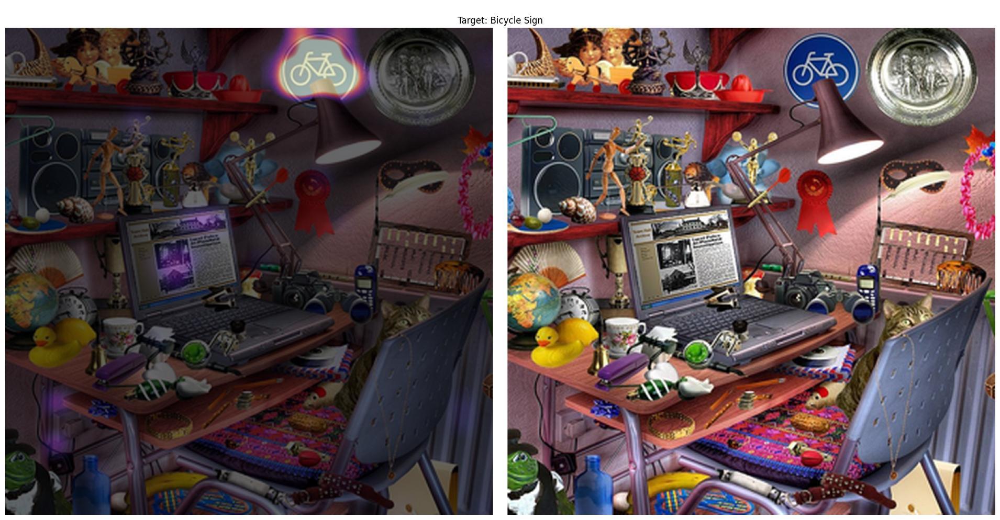



id_current: 1
image_id_current: hidden_objects_3
image_i: 1
label_natural: Cat



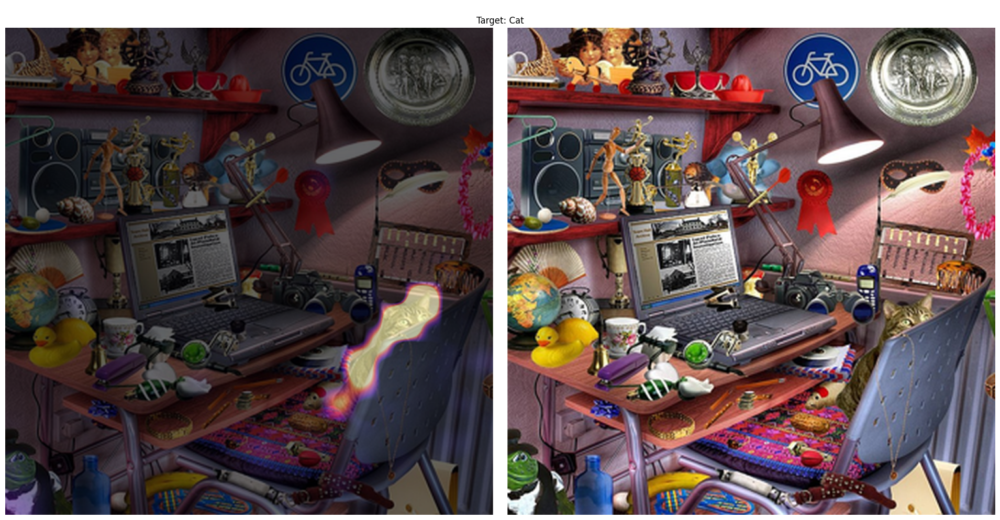



id_current: 2
image_id_current: hidden_objects_3
image_i: 2
label_natural: Boombox



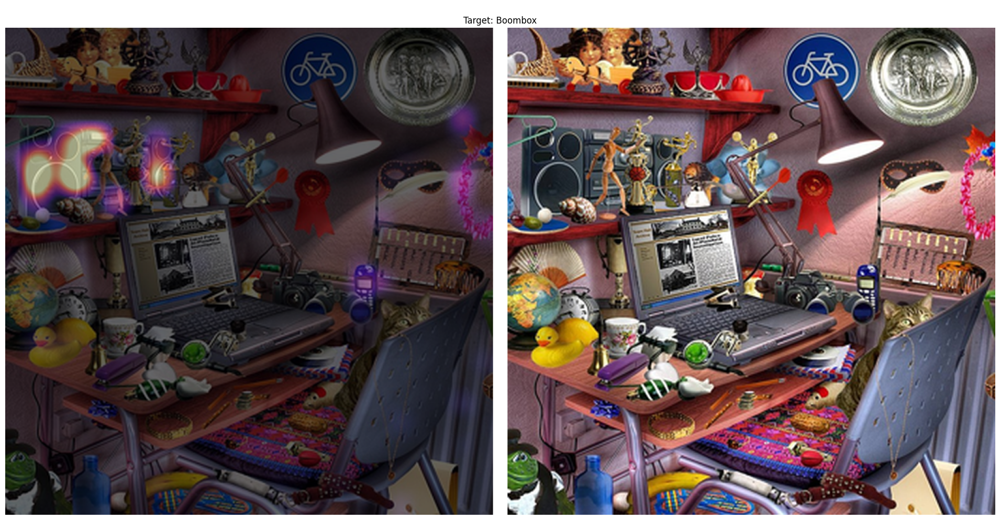


ic| target_labels: 'gt'
ImageIxG: computing ...
transform_fullgrad: detected prefix of model: CustomTextCLIP.visual.trunk.
transform_fullgrad: detected prefix of model: CustomTextCLIP.visual.trunk.
selected attribution methods' count: 573

id_current: 3
image_id_current: fruit
image_i: 0
label_natural: Kiwi



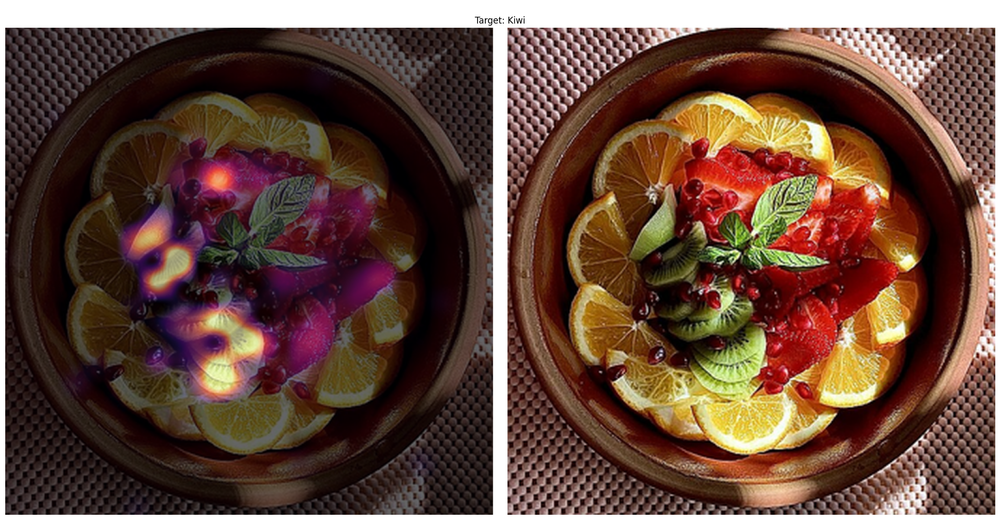



id_current: 4
image_id_current: fruit
image_i: 1
label_natural: Strawberries



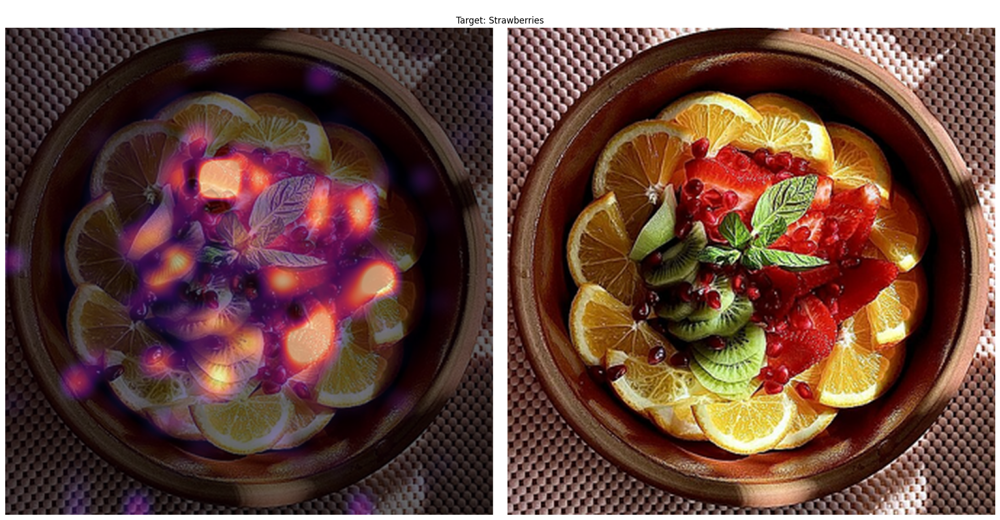



id_current: 5
image_id_current: fruit
image_i: 2
label_natural: Pomegranate Seeds



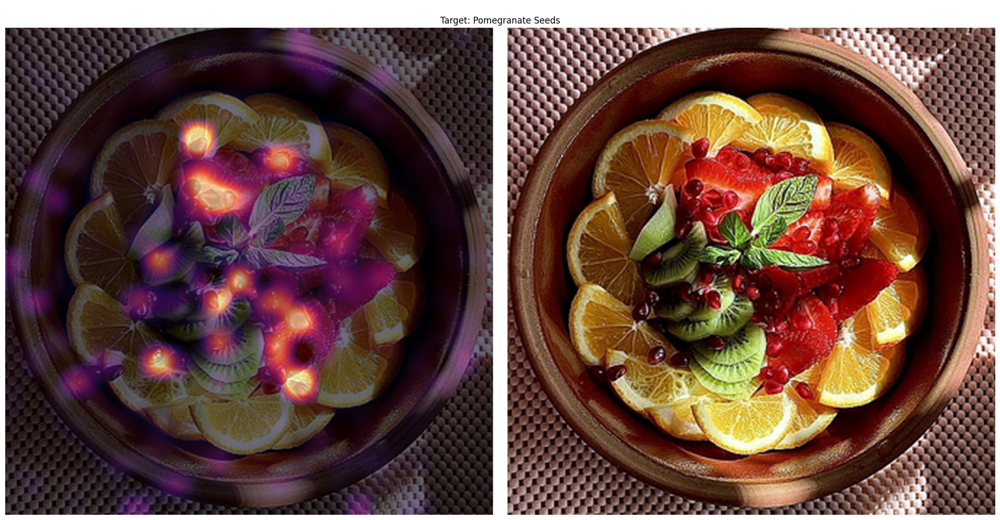


ic| target_labels: 'gt'
ImageIxG: computing ...
transform_fullgrad: detected prefix of model: CustomTextCLIP.visual.trunk.
transform_fullgrad: detected prefix of model: CustomTextCLIP.visual.trunk.
selected attribution methods' count: 573

id_current: 6
image_id_current: fruit
image_i: 0
label_natural: Orange Slices



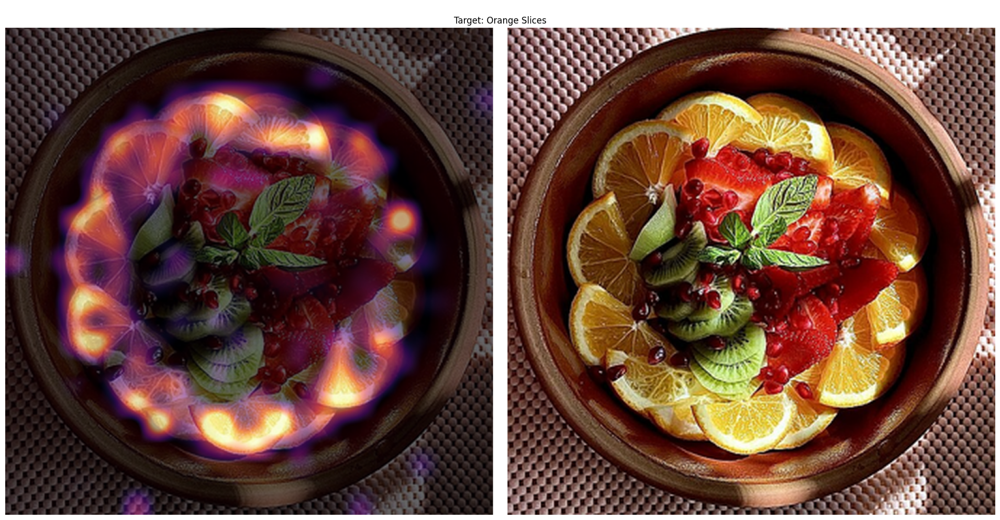


attributions_show2: finished


In [7]:
compute_qual_clip(
    dataset_name="some_name",
    ds=clip_ds,
    batch_size=3,  #: CHANGE THIS according to your VRAM size.
    title_mode="minimal",
    title="",
    plot_output_p=True,
    export_pixel_attr_alone_p=False,
    overlay_nonscaled_p=False,
    attributions_cols=[
        "attributions_s_CAT_s:sum_sum_FGrad_s:sum",  #: FullGrad+
    ],
)